# Skip to the bottom for the netowrkx code

In [1]:
import warnings

import geopandas
import libpysal
import momepy
import pandas
import geopy
import numpy
import geopandas as gpd

from clustergram import Clustergram

import matplotlib.pyplot as plt
from bokeh.io import output_notebook
from bokeh.plotting import show
from shapely.geometry import Point
import matplotlib.colors as mcolors
from shapely.geometry import MultiPolygon

import osmnx as ox

/tmp/ipykernel_1202619/3341468978.py:3: UserWarning: Shapely 2.0 is installed, but because PyGEOS is also installed, GeoPandas will still use PyGEOS by default for now. To force to use and test Shapely 2.0, you have to set the environment variable USE_PYGEOS=0. You can do this before starting the Python process, or in your code before importing geopandas:

import os
os.environ['USE_PYGEOS'] = '0'
import geopandas

In a future release, GeoPandas will switch to using Shapely by default. If you are using PyGEOS directly (calling PyGEOS functions on geometries from GeoPandas), this will then stop working and you are encouraged to migrate from PyGEOS to Shapely 2.0 (https://shapely.readthedocs.io/en/latest/migration_pygeos.html).
  import geopandas
/home/virgilxw/miniconda3/envs/ox/lib/python3.11/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import 

In [2]:
local_crs = 3414

place = "Singapore"

latlng = (1.29, 103.85)
dist = 30000

study_area = gpd.read_file("./Singapore_studyArea.shp").to_crs(epsg=4326)

# assuming your geodataframe is called `gdf` and the geometry column is called `geometry`
study_area = study_area.geometry.unary_union


In [3]:
# buildings = ox.geometries.geometries_from_place(place, tags={'building':True})
# buildings = ox.geometries.geometries_from_point(latlng, tags={'building':True}, dist=dist)
buildings = ox.geometries.geometries_from_polygon(study_area, tags={'building':True})
buildings.head()

amenity                   geometry addr:street  \
element_type osmid                                                      
node         518475196     NaN  POINT (103.81225 1.30876)         NaN   
             965698989     NaN  POINT (103.82913 1.29577)         NaN   
             965700669     NaN  POINT (103.82906 1.29618)         NaN   
             965700671     NaN  POINT (103.82825 1.29639)         NaN   
             965700673     NaN  POINT (103.83048 1.29633)         NaN   

                       entrance alt_name bench  bin  bus highway location  \
element_type osmid                                                          
node         518475196      NaN      NaN   NaN  NaN  NaN     NaN      NaN   
             965698989      NaN      NaN   NaN  NaN  NaN     NaN      NaN   
             965700669      NaN      NaN   NaN  NaN  NaN     NaN      NaN   
             965700671      NaN      NaN   NaN  NaN  NaN     NaN      NaN   
             965700673      NaN      NaN   NaN  NaN  NaN     NaN      NaN   

                        ... ways building:1992-2017 name:1992-2017 name:vi  \
element_type osmid      ...                                                  
node         518475196  ...  NaN                NaN            NaN     NaN   
             965698989  ...  NaN                NaN            NaN     NaN   
             965700669  ...  NaN                NaN            NaN     NaN   
             965700671  ...  NaN                NaN            NaN     NaN   
             965700673  ...  NaN                NaN            NaN     NaN   

                       garden:type parking:condition:both parking:lane:both  \
element_type osmid                                                            
node         518475196         NaN                    NaN               NaN   
             965698989         NaN                    NaN               NaN   
             965700669         NaN                    NaN               NaN   
             965700671         NaN                    NaN               NaN   
             965700673         NaN                    NaN               NaN   

                       end_date payment:activesg_app_credits roof:level  
element_type osmid                                                       
node         518475196      NaN                          NaN        NaN  
             965698989      NaN                          NaN        NaN  
             965700669      NaN                          NaN        NaN  
             965700671      NaN                          NaN        NaN  
             965700673      NaN                          NaN        NaN  

[5 rows x 423 columns]

In [4]:
buildings.head()

buildings = buildings[buildings.geom_type == "Polygon"].reset_index(drop=True)
buildings = buildings[["geometry"]].to_crs(local_crs)
print(buildings.geom_type.value_counts())


Polygon    112491
dtype: int64


Above loads building into a geojson file

In [5]:
buildings.head()

,geometry
0,"POLYGON ((18617.869 36738.578, 18629.743 36729..."
1,"POLYGON ((13728.615 35618.333, 13736.938 35595..."
2,"POLYGON ((34094.370 39221.964, 34088.449 39229..."
3,"POLYGON ((45916.033 38548.540, 45911.592 38554..."
4,"POLYGON ((30198.721 31654.180, 30193.001 31658..."


In [6]:
buildings["uID"] = range(len(buildings))
buildings.head()

,geometry,uID
0,"POLYGON ((18617.869 36738.578, 18629.743 36729...",0
1,"POLYGON ((13728.615 35618.333, 13736.938 35595...",1
2,"POLYGON ((34094.370 39221.964, 34088.449 39229...",2
3,"POLYGON ((45916.033 38548.540, 45911.592 38554...",3
4,"POLYGON ((30198.721 31654.180, 30193.001 31658...",4


In [7]:
# osm_graph = ox.graph_from_point(latlng, dist=dist, network_type='drive')

osm_graph= ox.graph.graph_from_polygon(study_area, network_type='drive')
osm_graph = ox.projection.project_graph(osm_graph, to_crs=local_crs)
streets = ox.graph_to_gdfs(
    osm_graph,
    nodes=False,
    edges=True,
    node_geometry=False,
    fill_edge_geometry=True
)
streets.head()

osmid  \
u          v          key                                                      
25451915   25451918   0    [166741187, 649636776, 649636777, 717446235, 2...   
25451918   242636478  0                                             22617511   
           1143899970 0                                            166741192   
242636478  4656921454 0                      [37584993, 37584994, 655660141]   
1143899970 1782376557 0                                            200159288   

                           oneway      lanes  ref                    name  \
u          v          key                                                   
25451915   25451918   0      True     [4, 3]  ECP      East Coast Parkway   
25451918   242636478  0      True          1  NaN                     NaN   
           1143899970 0      True          3  ECP      East Coast Parkway   
242636478  4656921454 0      True  [2, 4, 3]  NaN  Tanah Merah Coast Road   
1143899970 1782376557 0      True          3  ECP      East Coast Parkway   

                                 highway maxspeed reversed   length bridge  \
u          v          key                                                    
25451915   25451918   0         motorway       90    False  963.113    yes   
25451918   242636478  0    motorway_link       50    False  278.409    NaN   
           1143899970 0         motorway       90    False  670.252    NaN   
242636478  4656921454 0          primary       60    False  301.106    yes   
1143899970 1782376557 0         motorway       90    False  314.233    NaN   

                                                                    geometry  \
u          v          key                                                      
25451915   25451918   0    LINESTRING (44186.853 35217.240, 44144.233 351...   
25451918   242636478  0    LINESTRING (43649.291 34422.228, 43648.779 344...   
           1143899970 0    LINESTRING (43649.291 34422.228, 43492.918 342...   
242636478  4656921454 0    LINESTRING (43724.424 34208.291, 43746.393 342...   
1143899970 1782376557 0    LINESTRING (43269.766 33872.637, 43113.671 336...   

                          access tunnel junction width  
u          v          key                               
25451915   25451918   0      NaN    NaN      NaN   NaN  
25451918   242636478  0      NaN    NaN      NaN   NaN  
           1143899970 0      NaN    NaN      NaN   NaN  
242636478  4656921454 0      yes    NaN      NaN   NaN  
1143899970 1782376557 0      NaN    NaN      NaN   NaN

In [8]:
streets = momepy.remove_false_nodes(streets)
streets = streets[["geometry"]]
streets["nID"] = range(len(streets))

/home/virgilxw/miniconda3/envs/ox/lib/python3.11/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as SVY21 / Singapore TM (the single non-null crs provided).
  warnings.warn(


In [9]:
# Get the water bodies as geometries
water_bodies = ox.geometries_from_polygon(study_area, tags={'natural': 'water'}).set_crs("epsg: 4326").to_crs(local_crs)

water_bodies_boundaries = []

coastlines = ox.geometries_from_polygon(study_area, tags={'natural': 'coastline'}).set_crs("epsg: 4326").to_crs(local_crs)

coastlines = coastlines[coastlines.geom_type == "LineString"].reset_index(drop=True)

for coastline in coastlines.geometry:
    # Create a LineString object from the coordinates
    water_bodies_boundaries.append(coastline)

# # Create a GeoDataFrame of the water area boundaries
water_bodies_boundaries = gpd.GeoDataFrame(geometry=water_bodies_boundaries)
water_bodies_boundaries = water_bodies_boundaries[["geometry"]]
water_bodies_boundaries.head()

,geometry
0,"LINESTRING (39764.807 44081.123, 39812.384 440..."
1,"LINESTRING (15885.928 48093.216, 15867.966 480..."
2,"LINESTRING (25551.976 27234.130, 25570.517 272..."
3,"LINESTRING (27447.018 24893.329, 27435.666 248..."
4,"LINESTRING (26317.567 26949.218, 26277.268 269..."


In [10]:
enclosures = momepy.enclosures(streets, limit=gpd.GeoSeries([study_area]), additional_barriers=[water_bodies_boundaries])

/home/virgilxw/miniconda3/envs/ox/lib/python3.11/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as SVY21 / Singapore TM (the single non-null crs provided).
  warnings.warn(
/home/virgilxw/miniconda3/envs/ox/lib/python3.11/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as SVY21 / Singapore TM (the single non-null crs provided).
  warnings.warn(


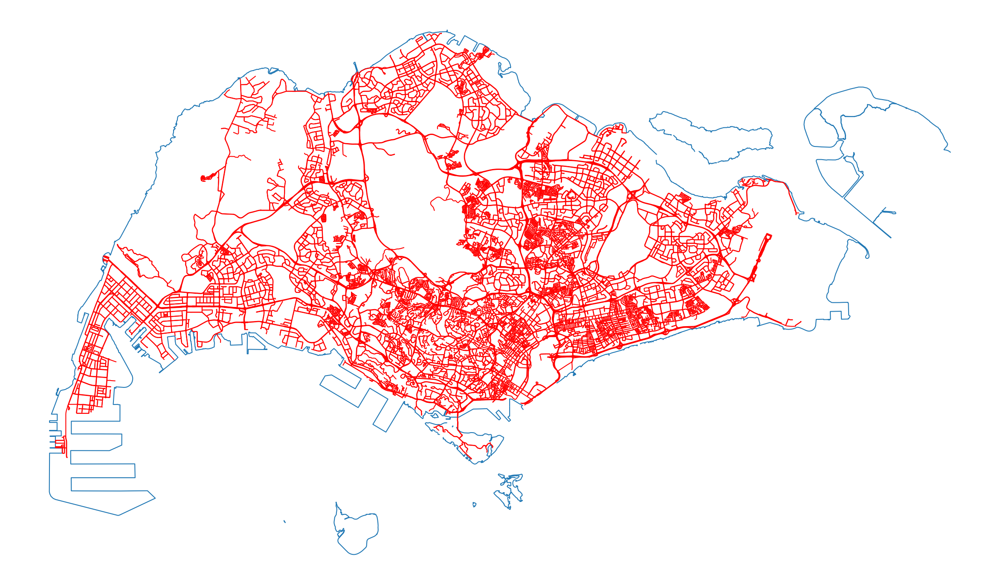

In [11]:
f, ax = plt.subplots(figsize=(30, 30))

water_bodies_boundaries.plot(ax=ax)
streets.plot(ax=ax, color='r')

ax.set_axis_off()
plt.show()

In [12]:
# limit = momepy.buffered_limit(buildings, 100)

tessellation = momepy.Tessellation(buildings, unique_id='uID', verbose=True, segment=1, use_dask=True, enclosures=enclosures).tessellation

# for debugging
tessellation_copy = tessellation

/home/virgilxw/miniconda3/envs/ox/lib/python3.11/site-packages/momepy/coins.py:15: UserWarning: Shapely 2.0 is installed, but because PyGEOS is also installed, GeoPandas will still use PyGEOS by default for now. To force to use and test Shapely 2.0, you have to set the environment variable USE_PYGEOS=0. You can do this before starting the Python process, or in your code before importing geopandas:

import os
os.environ['USE_PYGEOS'] = '0'
import geopandas

In a future release, GeoPandas will switch to using Shapely by default. If you are using PyGEOS directly (calling PyGEOS functions on geometries from GeoPandas), this will then stop working and you are encouraged to migrate from PyGEOS to Shapely 2.0 (https://shapely.readthedocs.io/en/latest/migration_pygeos.html).
  import geopandas as gpd
/home/virgilxw/miniconda3/envs/ox/lib/python3.11/site-packages/momepy/coins.py:15: UserWarning: Shapely 2.0 is installed, but because PyGEOS is also installed, GeoPandas will still use PyGEOS by d

In [13]:
tessellation = tessellation_copy

tessellation = tessellation.dropna()
tessellation['savedindex'] = tessellation.index

# Find the polygons that intersect. Keep savedindex as a series
intersecting = water_bodies.sjoin(tessellation, how='inner')['savedindex']

# Filter away these, "savedindex is not in intersecting"
tessellation = tessellation[~tessellation.savedindex.isin(intersecting)]

# Merge those with the same uid, that is very often just something bisected by a road
tessellation = tessellation.dissolve(by='uID').reset_index()


/home/virgilxw/miniconda3/envs/ox/lib/python3.11/site-packages/geopandas/geodataframe.py:1443: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)


In [14]:
# Check for duplicates based on UID
duplicates = buildings[buildings.duplicated(subset='uID', keep=False)]

buildings.to_file( place + 'buildings.shp', driver='ESRI Shapefile')

# Print the duplicate rows
if len(duplicates) > 0:
    print("Buildings: Duplicate UID entries:")
    print(duplicates.head())
    
else:
    print("Buildings: No duplicate UID entries found.")

# Check for duplicates based on UID
duplicates = tessellation[tessellation.duplicated(subset='uID', keep=False)]

tessellation.to_file( place + 'tess.shp', driver='ESRI Shapefile')

duplicates.to_file( place + 'errors.shp', driver='ESRI Shapefile')

# Print the duplicate rows
if len(duplicates) > 0:
    print("Tesselation: Duplicate UID entries:")
    print(duplicates.head())
else:
    print("Tesselation: No duplicate UID entries found.")

Buildings: No duplicate UID entries found.
Tesselation: No duplicate UID entries found.


/home/virgilxw/miniconda3/envs/ox/lib/python3.11/site-packages/geopandas/io/file.py:545: UserWarning: You are attempting to write an empty DataFrame to file. For some drivers, this operation may fail.
  _to_file_fiona(df, filename, driver, schema, crs, mode, **kwargs)


In [15]:
buildings = buildings.sjoin_nearest(streets, max_distance=1000, how="left")
buildings.head()

,geometry,uID,index_right,nID
0,"POLYGON ((18617.869 36738.578, 18629.743 36729...",0,35373.0,35373.0
1,"POLYGON ((13728.615 35618.333, 13736.938 35595...",1,3436.0,3436.0
2,"POLYGON ((34094.370 39221.964, 34088.449 39229...",2,17368.0,17368.0
3,"POLYGON ((45916.033 38548.540, 45911.592 38554...",3,5926.0,5926.0
3,"POLYGON ((45916.033 38548.540, 45911.592 38554...",3,28897.0,28897.0


In [16]:
buildings = buildings.drop_duplicates("uID").drop(columns="index_right")
tessellation = tessellation.merge(buildings[['uID', 'nID']], on='uID', how='left')


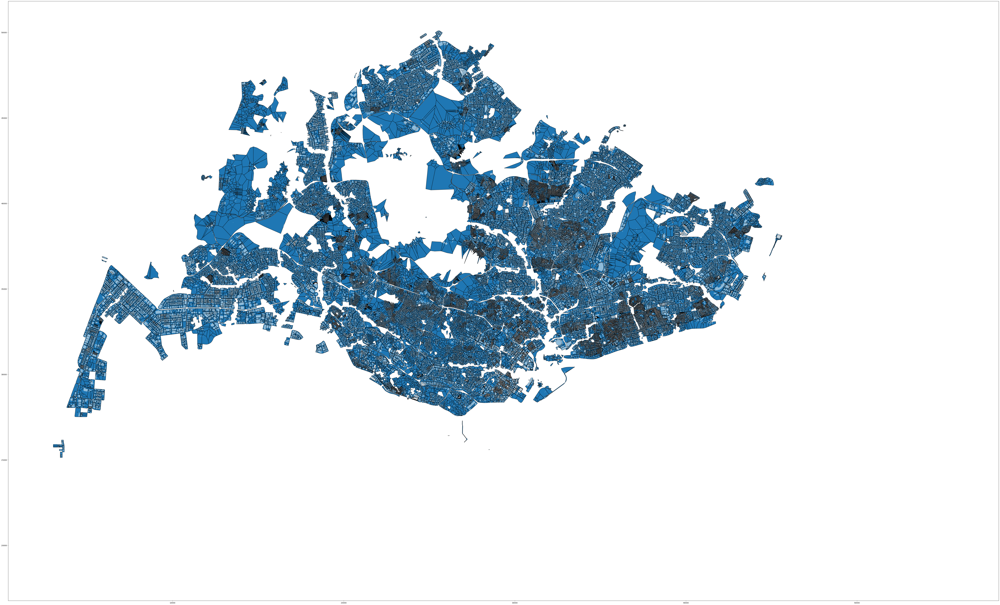

In [17]:
f, ax = plt.subplots(figsize=(100, 100))
tessellation.plot(ax=ax, edgecolor='black')
buildings.plot(ax=ax, color='white', alpha=.5)
plt.show()

/home/virgilxw/miniconda3/envs/ox/lib/python3.11/site-packages/momepy/shape.py:1286: ShapelyDeprecationWarning: The 'type' attribute is deprecated, and will be removed in the future. You can use the 'geom_type' attribute instead.
  if geom.type == "LineString"


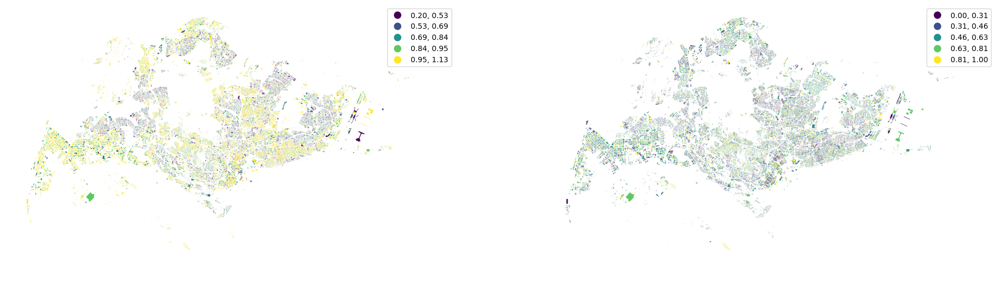

In [18]:
buildings["area"] = buildings.area
tessellation["area"] = tessellation.area
streets["length"] = streets.length

buildings['eri'] = momepy.EquivalentRectangularIndex(buildings).series
buildings['elongation'] = momepy.Elongation(buildings).series
tessellation['convexity'] = momepy.Convexity(tessellation).series
streets["linearity"] = momepy.Linearity(streets).series

fig, ax = plt.subplots(1, 2, figsize=(24, 12))

buildings.plot("eri", ax=ax[0], scheme="natural_breaks", legend=True)
buildings.plot("elongation", ax=ax[1], scheme="natural_breaks", legend=True)

ax[0].set_axis_off()
ax[1].set_axis_off()

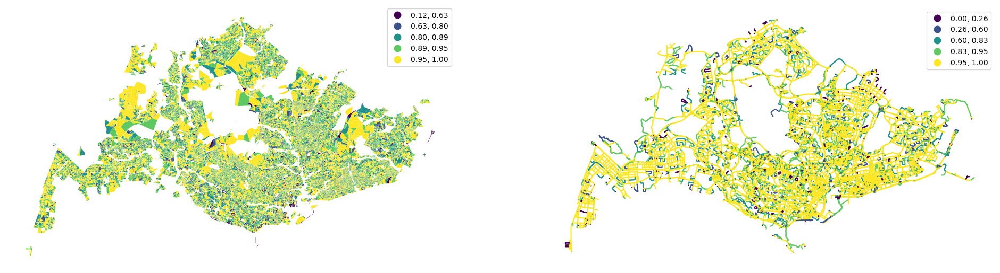

In [19]:
fig, ax = plt.subplots(1, 2, figsize=(24, 12))

tessellation.plot("convexity", ax=ax[0], scheme="natural_breaks", legend=True)
streets.plot("linearity", ax=ax[1], scheme="natural_breaks", legend=True)

ax[0].set_axis_off()
ax[1].set_axis_off()

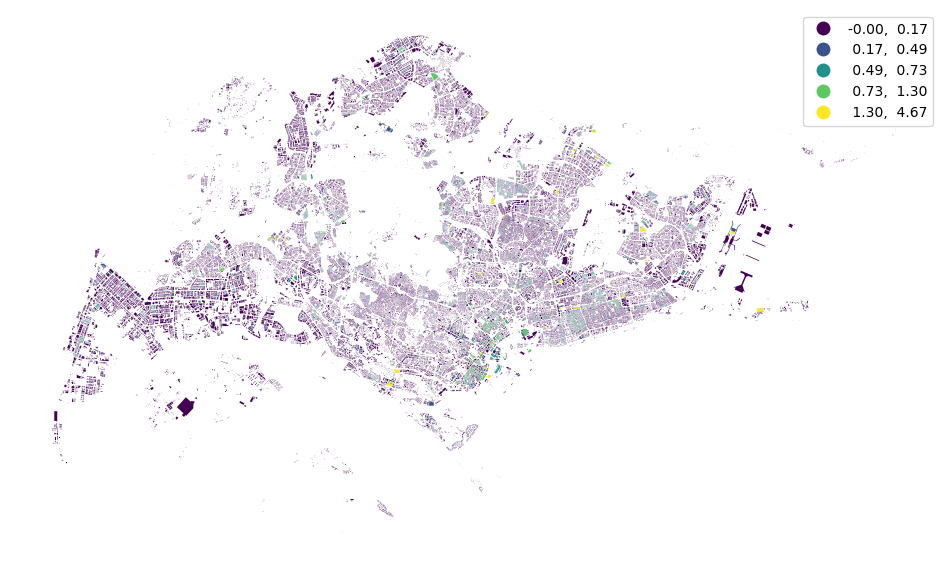

: 

In [20]:
buildings["shared_walls"] = momepy.SharedWallsRatio(buildings).series
buildings.plot("shared_walls", figsize=(12, 12), scheme="natural_breaks", legend=True).set_axis_off()

In [ ]:
import dask.dataframe as dd
import dask_geopandas as dask_geopandas
from dask.distributed import Client, LocalCluster, as_completed

In [ ]:
workers = 8
client = Client(LocalCluster(n_workers=workers, threads_per_worker=1))
client

In [ ]:
def generate_w(chunk_id):
    # load cells of a chunk
    cells = geopandas.read_parquet(f"../../urbangrammar_samba/spatial_signatures/morphometrics/cells/cells_{chunk_id}.pq")
    
    # add neighbouring cells from other chunks
    cross_chunk_cells = []
    
    for chunk, inds in cross_chunk.loc[chunk_id].indices.iteritems():
        add_cells = geopandas.read_parquet(f"../../urbangrammar_samba/spatial_signatures/morphometrics/cells/cells_{chunk}.pq").iloc[inds]
        cross_chunk_cells.append(add_cells)
    
    df = cells.append(pd.concat(cross_chunk_cells, ignore_index=True), ignore_index=True)

    w = libpysal.weights.Queen.from_dataframe(df, geom_col='tessellation')
    w3 = momepy.sw_high(k=3, weights=w)
    
    scipy.sparse.save_npz(f"./weights/w_{chunk_id}.npz", w.sparse)
    scipy.sparse.save_npz(f"./weights/w3_{chunk_id}.npz", w3.sparse)
    
    return f"Chunk {chunk_id} processed sucessfully."

In [ ]:
%%time
inputs = iter(range(103))
futures = [client.submit(generate_w, next(inputs)) for i in range(workers)]
ac = as_completed(futures)
for finished_future in ac:
    # submit new future 
    try:
        new_future = client.submit(generate_w, next(inputs))
        ac.add(new_future)
    except StopIteration:
        pass
    print(finished_future.result())

In [ ]:
client.close()